In [ ]:
import pdb
import ipdb
import math
import torchvision
import torchvision.transforms as transforms
import torch
import numpy as np
import pickle as pkl
import ipdb
import skimage
from skimage.measure import block_reduce
import torch.optim as optim

from IPython.display import Audio

import matplotlib.pyplot as plt
%matplotlib inline

class AudioFunctionWrapper:

    def __init__(self):
        self.heap = None

    def initAsm(self, heap_size):
        # rounded_heap_size = getNextValidFloat32HeapLength(heap_size)
        # self.heap = np.zeros(rounded_heap_size)
        self.heap = np.zeros(heap_size)

        # self.audio_funcs = audio_functions(window, foreignFunctions, heapBuffer)
        self.audio_funcs = audio_functions(self.heap)


    def pluckDecayedSine(self, buffer, sample_rate, hz, velocity, decay_factor):

        required_heap_size = len(buffer)

        self.initAsm(required_heap_size)

        heapOffsets = { 'targetStart': 0,
                        'targetEnd': len(buffer) - 1 }

        self.audio_funcs['renderDecayedSine'](heapOffsets['targetStart'],
                                              heapOffsets['targetEnd'],
                                              sample_rate,
                                              hz,
                                              velocity,
                                              decay_factor)

        return self.heap


    def pluck(self, buffer, seedNoise, sample_rate, hz, smoothingFactor,
              velocity, options, acousticLocation):

        required_heap_size = len(seedNoise) + len(buffer)

        self.initAsm(required_heap_size)

        for i in range(len(seedNoise)):
            self.heap[i] = seedNoise[i]

        # ipdb.set_trace()

        heapOffsets = { 'seedStart': 0,
                        'seedEnd': len(seedNoise) - 1,
                        'targetStart': len(seedNoise),
                        'targetEnd': len(seedNoise) + len(buffer) - 1
                      }

        self.audio_funcs['renderKarplusStrong'](heapOffsets['seedStart'],
                                                heapOffsets['seedEnd'],
                                                heapOffsets['targetStart'],
                                                heapOffsets['targetEnd'],
                                                sample_rate,
                                                hz,
                                                velocity,
                                                smoothingFactor,
                                                options.string_tension,
                                                options.pluck_damping,
                                                options.pluck_damping_variation,
                                                options.character_variation)

        if options.body == "simple":
            self.audio_funcs['resonate'](heapOffsets['targetStart'], heapOffsets['targetEnd'])

        self.audio_funcs['fadeTails'](heapOffsets['targetStart'], heapOffsets['targetEnd'] - heapOffsets['targetStart'] + 1)

        # string.acousticLocation is set individually for each string such that
        # the lowest note has a value of -1 and the highest +1

        # stereoSpread = options.stereoSpread * acousticLocation

        # for negative stereoSpreads, the note is pushed to the left
        # for positive stereoSpreads, the note is pushed to the right

        return self.heap[heapOffsets['targetStart']:]


# the byte length must be 2^n for n in [12, 24],
# or for bigger heaps, 2^24 * n for n >= 1
# def getNextValidFloat32HeapLength(desiredLengthFloats):
#     desiredLengthBytes = desiredLengthFloats << 2

#     if desiredLengthBytes <= math.pow(2, 12):
#         heapLengthBytes = math.pow(2, 12)
#     elif (desiredLengthBytes < math.pow(2, 24)):
#         heapLengthBytes = math.pow(2, math.ceil(math.log2(desiredLengthBytes)))
#     else:
#         print("Heap length greater than 2^24 bytes not implemented")

#     return int(heapLengthBytes)


def audio_functions(heapBuffer):

    heap = heapBuffer

    # simple discrete-time low-pass filter from Wikipedia
    def lowPass(lastOutput, currentInput, smoothingFactor):
        currentOutput = smoothingFactor * currentInput + (1.0 - smoothingFactor) * lastOutput
        return currentOutput


    # simple discrete-time high-pass filter from Wikipedia
    def highPass(lastOutput, lastInput, currentInput, smoothingFactor):
        currentOutput = smoothingFactor * lastOutput + smoothingFactor * (currentInput - lastInput)
        return currentOutput


    def resonate(heapStart, heapEnd):
        # explicitly initialise all variables so types are declared
        r00 = 0.0
        f00 = 0.0
        r10 = 0.0
        f10 = 0.0
        f0 = 0.0
        c0 = 0.0
        c1 = 0.0
        r0 = 0.0
        r1 = 0.0
        i = 0

        resonatedSample = 0.0
        resonatedSamplePostHighPass = 0.0
        # by making the smoothing factor large, we make the cutoff
        # frequency very low, acting as just an offset remover
        highPassSmoothingFactor = 0.999
        lastOutput = 0.0
        lastInput = 0.0

        c0 = 2.0 * np.sin(np.pi * 3.4375 / 44100.0)
        c1 = 2.0 * np.sin(np.pi * 6.124928687214833 / 44100.0)
        r0 = 0.98
        r1 = 0.98

        # This for loop replaced by a while loop
        # for (i = heapStart << 2; (i|0) <= (heapEnd << 2); i = (i + 4)|0):
        i = heapStart << 2

        while i <= heapEnd << 2:
#             print("epoch %d: r00: %.6f, f00: %.6f, r10: %.6f, f10: %.6f, f0: %.6f, \\
#                   resonatedSample: %.6f, resonatedSamplePostHighPass: %.6f\\
#                   lastOutput: %.6, lastInput: %.6", (i, r00, f00, r10, f10, f0, resonatedSample, \\
#                                                      resonatedSamplePostHighPass, lastOutput, lastInput))
            ipdb.set_trace()
            r00 = r00 * r0
            r00 = r00 + (f0 - f00) * c0
            f00 = f00 + r00
            f00 = f00 - f00 * f00 * f00 * 0.166666666666666
            r10 = r10 * r1
            r10 = r10 + (f0 - f10) * c1
            f10 = f10 + r10
            #ipdb.set_trace()
            f10 = f10 - f10 * f10 * f10 * 0.166666666666666
            f0 = heap[i >> 2]
            resonatedSample = f0 + (f00 + f10) * 2.0

            # I'm not sure why, but the resonating process plays
            # havok with the DC offset - it jumps around everywhere.
            # We put it back to zero DC offset by adding a high-pass
            # filter with a super low cutoff frequency.
            resonatedSamplePostHighPass = highPass(lastOutput, lastInput, resonatedSample, highPassSmoothingFactor)
            heap[i >> 2] = resonatedSamplePostHighPass
            lastOutput = resonatedSamplePostHighPass
            lastInput = resonatedSample

            i = i + 4


    # apply a fade envelope to the end of a buffer
    # to make it end at zero ampltiude
    # (to avoid clicks heard when sample otherwise suddenly
    #  cuts off)
    def fadeTails(heapStart, length):
        heapEnd = 0
        tailProportion = 0.0
        tailSamples = 0
        tailSamplesStart = 0
        i = 0
        samplesThroughTail = 0
        proportionThroughTail = 0.0
        gain = 0.0

        tailProportion = 0.1
        tailSamples = int(np.floor(length * tailProportion))
        tailSamplesStart = heapStart + length - tailSamples

        heapEnd = heapStart + length
        i = tailSamplesStart << 2
        samplesThroughTail = 0

        # for (i = tailSamplesStart << 2, samplesThroughTail = 0; (i|0) < (heapEnd << 2); i = (i + 4)|0, samplesThroughTail = (samplesThroughTail+1)|0):
        while i < heapEnd << 2:
            proportionThroughTail = samplesThroughTail / tailSamples
            gain = 1.0 - proportionThroughTail
            heap[i >> 2] = heap[i >> 2] * gain

            i += 4
            samplesThroughTail += 1


    # the "smoothing factor" parameter is the coefficient
    # used on the terms in the main low-pass filter in the
    # Karplus-Strong loop
    def renderKarplusStrong(seedNoiseStart,
                            seedNoiseEnd,
                            targetArrayStart,
                            targetArrayEnd,
                            sample_rate, hz, velocity,
                            smoothingFactor, stringTension,
                            pluckDamping,
                            pluckDampingVariation,
                            characterVariation):

        period = 0.0
        periodSamples = 0
        sampleCount = 0
        lastOutputSample = 0.0
        curInputSample = 0.0
        noiseSample = 0.0
        skipSamplesFromTension = 0
        curOutputSample = 0.0
        pluckDampingMin = 0.0
        pluckDampingMax = 0.0
        pluckDampingVariationMin = 0.0
        pluckDampingVariationMax = 0.0
        pluckDampingVariationDifference = 0.0
        pluckDampingCoefficient = 0.0

        # the index of the heap as a whole that we get noise samples from
        heapNoiseIndexBytes = 0
        # the index of the portion of the heap that we'll be writing to
        targetIndex = 0
        # the index of the heap as a whole where we'll be writing
        heapTargetIndexBytes = 0
        # the index of the heap as a whole of the start of the last period of samples
        lastPeriodStartIndexBytes = 0
        # the index of the heap as a whole from where we'll be taking samples from the last period, after
        # having added the skip from tension
        lastPeriodInputIndexBytes = 0
        period = 1.0 / hz
        periodSamples = int(np.round(period * sample_rate))
        sampleCount = targetArrayEnd - targetArrayStart + 1

        # /*
        # |- pluckDampingMax
        # |
        # |               | - pluckDampingVariationMax         | -
        # |               | (pluckDampingMax - pluckDamping) * |
        # |               | pluckDampingVariation              | pluckDamping
        # |- pluckDamping | -                                  | Variation
        # |               | (pluckDamping - pluckDampingMin) * | Difference
        # |               | pluckDampingVariation              |
        # |               | - pluckDampingVariationMin         | -
        # |
        # |- pluckDampingMin
        # */
        pluckDampingMin = 0.1
        pluckDampingMax = 0.9
        pluckDampingVariationMin = pluckDamping - (pluckDamping - pluckDampingMin) * pluckDampingVariation
        pluckDampingVariationMax = pluckDamping + (pluckDampingMax - pluckDamping) * pluckDampingVariation
        pluckDampingVariationDifference = pluckDampingVariationMax - pluckDampingVariationMin
        pluckDampingCoefficient = pluckDampingVariationMin + np.random.rand() * pluckDampingVariationDifference

        # for (targetIndex = 0; (targetIndex|0) < (sampleCount|0); targetIndex = (targetIndex + 1)|0):
        targetIndex = 0
        while targetIndex < sampleCount:

            heapTargetIndexBytes = (targetArrayStart + targetIndex) << 2

            if targetIndex < periodSamples:
                # for the first period, feed in noise remember, heap index has to be bytes...
                heapNoiseIndexBytes = (seedNoiseStart + targetIndex) << 2
                noiseSample = heap[heapNoiseIndexBytes >> 2]
                # create room for character variation noise
                noiseSample = noiseSample * (1.0 - characterVariation)
                # add character variation
                noiseSample = noiseSample + characterVariation * (-1.0 + 2.0 * np.random.rand())
                # also velocity
                noiseSample = noiseSample * velocity
                # by varying 'pluck damping', we can control the spectral content of the input noise
                curInputSample = lowPass(curInputSample, noiseSample, pluckDampingCoefficient)
            elif stringTension != 1.0:
                # for subsequent periods, feed in the output from about one period ago
                lastPeriodStartIndexBytes = heapTargetIndexBytes - (periodSamples << 2)
                skipSamplesFromTension = int(np.floor(stringTension * periodSamples))
                lastPeriodInputIndexBytes = lastPeriodStartIndexBytes + (skipSamplesFromTension << 2)
                curInputSample = heap[lastPeriodInputIndexBytes >> 2]
            else:
                # if stringTension == 1.0, we would be reading from the
                # same sample we were writing to
                # ordinarily, self would have the effect that only the first
                # period of noise was preserved, and the rest of the buffer
                # would be silence, but because we're reusing the heap,
                # we'd actually be reading samples from old waves
                curInputSample = 0.0

            # the current period is generated by applying a low-pass
            # filter to the last period
            curOutputSample = lowPass(lastOutputSample, curInputSample, smoothingFactor)

            heap[heapTargetIndexBytes >> 2] = curOutputSample
            lastOutputSample = curOutputSample

            targetIndex += 1


    def renderDecayedSine(targetArrayStart,
                          targetArrayEnd,
                          sample_rate, hz, velocity,
                          decay_factor):
        period = 0.0
        periodSamples = 0
        sampleCount = 0
        # the index of the portion of the heap that we'll be writing to
        targetIndex = 0
        # the index of the heap as a whole where we'll be writing
        heapTargetIndexBytes = 0

        time = 0.0

        period = 1.0 / hz
        periodSamples = np.round(period * sample_rate)
        sampleCount = targetArrayEnd - targetArrayStart + 1

        # for (targetIndex = 0; (targetIndex|0) < (sampleCount|0); targetIndex = (targetIndex + 1)|0):
        targetIndex = 0
        while targetIndex < sampleCount:

            heapTargetIndexBytes = (targetArrayStart + targetIndex) << 2

            time = targetIndex / sample_rate
            heap[heapTargetIndexBytes >> 2] = velocity * math.pow(2.0, -decay_factor*time) * np.sin(2.0 * np.pi * hz * time)

            targetIndex += 1

    return { 'renderKarplusStrong': renderKarplusStrong,
             'renderDecayedSine': renderDecayedSine,
             'fadeTails': fadeTails,
             'resonate': resonate }


In [404]:
class Options:
    
    def __init__(self, character_variation = 0.5, string_damping=0.5, string_damping_variation=0.25, pluck_damping=0.5,
                pluck_damping_variation=0.25, string_tension=0.1, stereo_spread=0.2, string_damping_calculation='magic', 
                body='simple', mode='karplus-strong'):

        self.character_variation = character_variation
        self.string_damping=string_damping
        self.string_damping_variation=string_damping_variation
        self.pluck_damping=pluck_damping
        self.pluck_damping_variation=pluck_damping_variation
        self.string_tension=string_tension
        self.stereo_spread=stereo_spread
        self.string_damping_calculation=string_damping_calculation
        self.body=body
        self.mode=mode

In [405]:
def cqt_specgram(audio, n_bins, bins_per_octave, hop_length, sr, fmin, filter_scale):
    '''
    :param audio:
    :param sr:
    :return: shape = (n_bins, t)
    '''
    c = librosa.cqt(audio, sr = sr, n_bins = n_bins, bins_per_octave = bins_per_octave, hop_length = hop_length,
                    fmin = fmin, filter_scale = filter_scale)
    mag, phase = librosa.core.magphase(c)
    c_p = librosa.amplitude_to_db(mag, amin=1e-13, top_db=120., ref=np.max) / 120.0 + 1.0
    return c_p

In [406]:
def compute_cqt_spec(audio, n_bins = 84 * 4, bins_per_octave=12 * 4, hop_length = 256, sr = 16000, fmin = librosa.note_to_hz('C1'),
             filter_scale = 0.8):
    return cqt_specgram(audio, n_bins, bins_per_octave, hop_length, sr, fmin, filter_scale)

In [748]:
def generate_seed_noise(num_samples):
    return np.random.rand(num_samples) * 2 - 1


#  calculate the constant used for the low-pass filter
# used in the Karplus-Strong loop
def calculate_smoothing_factor(string, tab, options):
    if options.string_damping_calculation == "direct":
        return options.string_damping
    elif options.string_damping_calculation == "magic":
        noteNumber = (string.semitone_index + tab - 19) / 44
        return options.string_damping + math.pow(noteNumber, 0.5) * (1 - options.string_damping) * 0.5 + (1 - options.string_damping) * np.random.rand() * options.string_damping_variation


class GuitarString:
    def __init__(self, string_num, octave, semitone, options):

        self.options = options

        # work from A0 as a reference,
        # since it has a nice round frequency
        a0_hz = 27.5
        # an increase in octave by 1 doubles the frequency
        # each octave is divided into 12 semitones
        # the scale goes C0, C0#, D0, D0#, E0, F0, F0#, G0, G0#, A0, A0#, B0
        # so go back 9 semitones to get to C0
        c0_hz = a0_hz * math.pow(2, -9 / 12)
        self.basicHz = c0_hz * math.pow(2, octave + semitone / 12)

        # ipdb.set_trace()
        basic_period = 1.0 / self.basicHz
        basic_period_num_samples = int(np.round(basic_period * 40000))  # TODO: audioCtx.sample_rate == 4000 ?
        self.seed_noise = generate_seed_noise(basic_period_num_samples)

        # this is only used in a magical calculation of filter coefficients
        self.semitone_index = octave * 12 + semitone - 9

        # ranges from -1 for first string to +1 for last
        self.acoustic_location = (string_num - 2.5) * 0.4
        #print(self.acoustic_location)
        #print(string_num)
        # self.mode = "karplus-strong"
        # self.mode = "sine"
        self.mode = options.mode
        self.func_wrapper = AudioFunctionWrapper()


    def createBuffer(self, sample_count):
        # We use 1 channel for simplicity
        return np.zeros(sample_count)


    def pluck(self, start_time, velocity, tab):
        # create the buffer we're going to write into
        channels = 1
        sample_rate = 40000  # TODO: audioCtx.sample_rate == 4000 ?
        sample_count = int(2.0 * sample_rate)  # 1 second buffer

        # buffer = self.createBuffer(channels, sample_count, sample_rate)
        buffer = self.createBuffer(sample_count)

        smoothing_factor = calculate_smoothing_factor(self, tab, self.options)
        # 'tab' represents which fret is held while plucking
        # each fret represents an increase in pitch by one semitone
        # (logarithmically, one-twelth of an octave)
        hz = self.basicHz * math.pow(2, tab / 12)

        velocity /= 4.0

        if self.mode == "karplus-strong":
            filled_buffer = self.func_wrapper.pluck(buffer,
                                                    self.seed_noise,
                                                    sample_rate,
                                                    hz,
                                                    smoothing_factor,
                                                    velocity,
                                                    self.options,
                                                    self.acoustic_location)
        elif self.mode == "sine":
            decayFactor = 8
            filled_buffer = self.func_wrapper.pluckDecayedSine(buffer,
                                                               sample_rate,
                                                               hz,
                                                               velocity,
                                                               decayFactor)

        return filled_buffer


In [408]:
class Guitar:

    # each fret represents an increase in pitch by one semitone
    # (logarithmically, one-twelth of an octave)
    # -1: don't pluck that string
    C_MAJOR = [-1, 3, 2, 0, 0, 0]
    G_MAJOR = [ 3, 2, 0, 0, 0, 3]
    A_MINOR = [ 0, 0, 2, 2, 0, 0]
    E_MINOR = [ 0, 2, 2, 0, 3, 0]

    def __init__(self, options):

        self.options = options

        self.strings = [
            # arguments are:
            # - string number
            # - octave
            # - semitone
            GuitarString(0, 2, 4,  options),   # E2
            GuitarString(1, 2, 9,  options),   # A2
            GuitarString(2, 3, 2,  options),   # D3
            GuitarString(3, 3, 7,  options),   # G3
            GuitarString(4, 3, 11, options),   # B3
            GuitarString(5, 4, 4,  options)    # E4
        ]

        
    def note(self, velocity, stringNumber, tab):
        buffer_result = self.strings[stringNumber].pluck(0, velocity, tab)
        return buffer_result
        
    def strum_chord(self, time, downstroke, velocity, chord):
    #def strum_chord(self, time, downstroke, velocity, chord, stringNumber):
        if downstroke:
            pluckOrder = [0, 1, 2, 3, 4, 5]
        else:
            pluckOrder = [5, 4, 3, 2, 1, 0]

        note_buffers = []

        for i in range(6):
            stringNumber = pluckOrder[i]
            if chord[stringNumber] != -1:
                # buffer_result = self.strings[stringNumber].pluck(time, velocity, chord[stringNumber])
                buffer_result = self.strings[stringNumber].pluck(0, velocity, chord[stringNumber])
                note_buffers.append(buffer_result)

            time += np.random.rand() / 128  # Do we want rand or randn? Or rand() centered at 0?

        as_strided = np.lib.stride_tricks.as_strided
        all_notes = np.concatenate(note_buffers)

        if chord[stringNumber] != -1:
            buffer_result = self.strings[stringNumber].pluck(0, velocity, chord[stringNumber])
            note_buffers.append(buffer_result)
        # overlap = 39000  # For 1-second samples
        overlap = 78000  # For 2-second samples
        added_notes = note_buffers[0]
        if len(note_buffers) > 1:
            for i in range(1, len(note_buffers)):
                added_notes = np.concatenate([added_notes[:-overlap], added_notes[-overlap:] + note_buffers[i][:overlap], note_buffers[i][overlap:]])

        # ipdb.set_trace()
        # added_notes = as_strided(all_notes, (6, 100), all_notes.strides * 2)

        # return np.concatenate(note_buffers)
        return added_notes

    def set_mode(self, mode):
        for string in self.strings:
            string.mode = mode


In [409]:
time_unit = 0.12

chords = [ Guitar.C_MAJOR,
           Guitar.G_MAJOR,
           Guitar.A_MINOR,
           Guitar.E_MINOR ]


# def play_strums(guitar, sequenceN, block_start_time, chord_index, precache_time):

#     cur_strum_start_time = 0

#     audio_buffers = []

#     #for i in range(13):
#     for i in range(1):
#         print(i)
#         chord = chords[chord_index]

#         if sequenceN % 13 == 0:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, True,  1.0, chord)
#         elif sequenceN % 13 == 1:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, True,  1.0, chord)
#         elif sequenceN % 13 == 2:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, False, 0.8, chord)
#         elif sequenceN % 13 == 3:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, False, 0.8, chord)
#         elif sequenceN % 13 == 4:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, True,  1.0, chord)
#         elif sequenceN % 13 == 5:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, False, 0.8, chord)
#         elif sequenceN % 13 == 6:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, True,  1.0, chord)
#         elif sequenceN % 13 == 7:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, True,  1.0, chord)
#         elif sequenceN % 13 == 8:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, False, 0.8, chord)
#         elif sequenceN % 13 == 9:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, False, 0.8, chord)
#         elif sequenceN % 13 == 10:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, True,  1.0, chord)
#         elif sequenceN % 13 == 11:
#             audio_buffer = guitar.strum_chord(cur_strum_start_time, False, 0.8, chord)
#         elif sequenceN % 13 == 12:
#             audio_buffer = guitar.strings[2].pluck(cur_strum_start_time, 0.7, chord[2])

#             # cur_strum_start_time = block_start_time + time_unit * 31.5
#             # audio_buffer = guitar.strings[1].pluck(cur_strum_start_time, 0.7, chord[1])

#             chord_index = (chord_index + 1) % 4
#             # block_start_time += time_unit * 32

#         chord_index = (chord_index + 1) % 4

#         audio_buffers.append(audio_buffer)
#         sequenceN += 1
#     return np.concatenate(audio_buffers)


def play_note(guitar, stringNumber, tab):
    audio_buffer = guitar.note(1.0, stringNumber, tab)
    return audio_buffer


def play_strums(guitar, sequenceN, block_start_time, chord_index, precache_time):
    cur_strum_start_time = 0
    chord = chords[chord_index]
    audio_buffer = guitar.strum_chord(cur_strum_start_time, True, 1.0, chord)
    return audio_buffer


def play_guitar(guitar):
    start_sequence_N = 0
    block_start_time = 10
    start_chord_index = 1
    precache_time = 0.0
    return play_strums(guitar, start_sequence_N, block_start_time, start_chord_index, precache_time)


(336, 313)


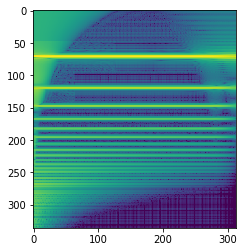

In [797]:
from IPython.display import Audio
options = Options()
guitar = Guitar(options=options)
audio_buffer = play_note(guitar, 0, 0)
display(Audio(audio_buffer, rate=40000))
cqt = compute_cqt_spec(audio_buffer, sr=40000, hop_length=256)
print(cqt.shape)
#librosa.output.write_wav('guitar_output.wav', audio_buffer, 40000)  # The 40000 is the sampling frequency
plt.imshow(cqt)

(336, 313)
False


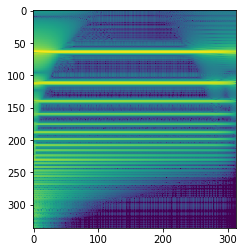

In [411]:
cqt2 = compute_cqt_spec(audio_buffer, sr=36000, hop_length=256) #sr=36000 sounds more reasonable
print(cqt2.shape)
plt.imshow(cqt2)
print(np.allclose(cqt, cqt2))

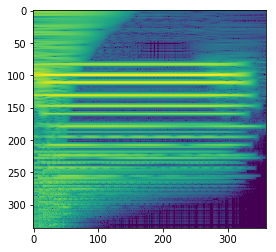

In [412]:
guitar = Guitar(options=options)
audio_buffer = play_guitar(guitar)
display(Audio(audio_buffer, rate=36000))
cqt = cqt_spec(audio_buffer, sr=40000, hop_length=256)
#librosa.output.write_wav('guitar_output.wav', audio_buffer, 40000)  # The 40000 is the sampling frequency
plt.imshow(cqt)

In [413]:
def pad_zeros(image, shape):
    result = np.zeros(shape)
    result[:image.shape[0],:image.shape[1]] = image
    return result

In [502]:
import pickle as pkl
def sample_params(size):
    character_variation = np.array([np.random.uniform(0, 1) for _ in range(size)], dtype=np.float32)
    string_damping = np.array([np.random.uniform(0, 0.7) for _ in range(size)], dtype=np.float32)
    string_damping_variation = np.array([np.random.uniform(0, 0.5) for _ in range(size)], dtype=np.float32)
    pluck_damping = np.array([np.random.uniform(0, 0.9) for _ in range(size)], dtype=np.float32)
    pluck_damping_variation = np.array([np.random.uniform(0, 0.5) for _ in range(size)], dtype=np.float32)
    string_tension = np.array([np.random.uniform(0, 1) for _ in range(size)], dtype=np.float32)
    stereo_spread = np.array([np.random.uniform(0, 1) for _ in range(size)], dtype=np.float32)
    stringNumber = np.array([math.floor(np.random.choice(np.arange(0, 6))) for _ in range(size)], dtype=np.int32)
    tab = np.array([math.floor(np.random.choice(np.arange(0, 12))) for _ in range(size)], dtype=np.int32)
#     print(stringNumber)
#     print(tab)
    #  ipdb.set_trace()
    options = []
    guitars = []
    audio_buffers = []
    cqt_specs = []
    for i in range(size):
        options.append(Options(character_variation[i], string_damping[i], string_damping_variation[i], pluck_damping[i], pluck_damping_variation[i], 
                         string_tension[i], stereo_spread[i]))
        guitars.append(Guitar(options=options[i]))
        audio_buffers.append(play_note(guitars[i], stringNumber[i], tab[i]))
#        print(audio_buffers[i])
#         try:
#             cqt_spec = compute_cqt_spec(audio_buffers[i]).T
#         except ParameterError:
#             print(audio_buffers[i])
        cqt_spec = compute_cqt_spec(audio_buffers[i]).T
        padded_cqt = pad_zeros(cqt_spec, (cqt_spec.shape[1], cqt_spec.shape[1]))
        cqt_specs.append(padded_cqt)
    cqt_specs = np.array(cqt_specs, dtype=np.float32)
    print(cqt_specs.shape)
    return character_variation, string_damping, string_damping_variation, pluck_damping, pluck_damping_variation, string_tension, stereo_spread, stringNumber, tab, cqt_specs
        

def generate_data(file, size):
    character_variation, string_damping, string_damping_variation, pluck_damping, pluck_damping_variation, string_tension, stereo_spread, stringNumber, tab, cqt_specs = sample_params(size)
    with open(file, 'wb') as fh:
        data_dict = {'parameters' : np.array([character_variation, string_damping, string_damping_variation, pluck_damping, pluck_damping_variation, string_tension, 
                stereo_spread, stringNumber, tab]).T, 'cqt_spec' : cqt_specs}
        pkl.dump(data_dict, fh)
    fh.close()
    print(file)
    
    
def read_data(file):
    with open(file, 'rb') as fh:
        data = pkl.loads(fh.read())
    fh.close()
    return data


def create_datasets():
    generate_data('val_.pkl', 10)
#     generate_data('test.pkl', 5000)
#     generate_data('eval.pkl', 5000)
#     generate_data('train.pkl', 50000)
    generate_data('test_.pkl', 10)
    generate_data('eval_.pkl', 10)
    generate_data('train_.pkl', 50)

    
def read_dataset():
    return read_data('train.pkl'), read_data('test.pkl'), read_data('val.pkl'), read_data('eval.pkl')

In [437]:
create_datasets()

(10, 336, 336)
val_.pkl
(10, 336, 336)
test_.pkl
(10, 336, 336)
eval_.pkl
(50, 336, 336)
train_.pkl


In [503]:
train_data, test_data, val_data, eval_data = read_dataset()

In [544]:
import torch

class MyDataset(torch.utils.data.Dataset):
    def __init__(self, parameters, cqt_spectrograms):
        super(MyDataset, self).__init__()
        
        self.parameters = parameters
        self.cqt_spec = cqt_spectrograms
        #print(self.parameters.shape)
    
    def __getitem__(self, i):
        #print(self.parameters[i].shape)
        return self.cqt_spec[i].T, self.parameters[i]
    
    def __len__(self):
        return len(self.parameters)

In [545]:
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

trainset = MyDataset(parameters=train_data['parameters'], cqt_spectrograms=train_data['cqt_spec'])
trainloader = torch.utils.data.DataLoader(trainset, batch_size=32,
                                          shuffle=True, num_workers=2)

testset = MyDataset(parameters=test_data['parameters'], cqt_spectrograms=test_data['cqt_spec'])
testloader = torch.utils.data.DataLoader(testset, batch_size=32,
                                         shuffle=False, num_workers=2)

valset = MyDataset(parameters=val_data['parameters'], cqt_spectrograms=val_data['cqt_spec'])
valloader = torch.utils.data.DataLoader(valset, batch_size=32,
                                         shuffle=False, num_workers=2)

evalset = MyDataset(parameters=eval_data['parameters'], cqt_spectrograms=eval_data['cqt_spec'])
evalloader = torch.utils.data.DataLoader(evalset, batch_size=4,
                                         shuffle=False, num_workers=2)

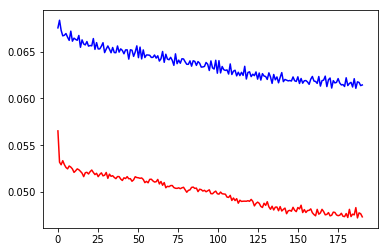

In [796]:
training_losses = []
logfile = open("train_losses.txt","r")
for line in logfile:
    training_losses.append(float(line))
val_losses = []
logfile = open("val_losses.txt","r")
for line in logfile:
    val_losses.append(float(line))
t = np.linspace(0, len(val_losses[10:]), len(val_losses[10:]))
plt.plot(t, np.array(training_losses[10:]), 'r')
plt.plot(t, np.array(val_losses[10:]), 'b')
plt.show()

In [546]:
import torch.nn as nn
import torch.nn.functional as F


class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(1, 6, 5)
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(6, 16, 5)
        self.fc1 = nn.Linear(9 * 108 * 108, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 9)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = x.view(-1, 9 * 108 * 108)  # -1 is the batch_size
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x


net = Net()

In [547]:
criterion = nn.MSELoss()
optimizer = optim.SGD(net.parameters(), lr=0.0001, momentum=0.9)
#optimizer = optim.Adam(net.parameters(), lr=0.0001)

In [548]:
def evaluate(net, validation_loader):
    val_loss = 0.0
    for i, data in enumerate(validation_loader, 0):

        inputs, labels = data
        inputs.unsqueeze_(1)
    
        outputs = net(inputs)
        loss = criterion(outputs, labels.float())

        # print statistics
        val_loss += loss.item()
    return val_loss / float(len(validation_loader.dataset))

In [549]:
for epoch in range(200):  # loop over the dataset multiple times

    running_loss = 0.0

    for i, data in enumerate(trainloader, 0):
        # get the inputs
        inputs, labels = data
        #print(inputs.shape)
        #print(labels.shape)
        inputs.unsqueeze_(1)
        #print(inputs.shape)
        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = net(inputs)
        loss = criterion(outputs, labels.float())
        loss.backward()
        optimizer.step()

        # print statistics
        running_loss += loss.item()
#        if i % 500 == 0:    # print every 20 mini-batches
#            print('[%d, %5d] loss: %.3f' %
#                  (epoch + 1, i + 1, running_loss/500))
#            running_loss = 0.0

    print('epoch %d train_loss: %.6f' % (epoch + 1, running_loss/float(len(trainloader.dataset))))
    with open("train_losses.txt", "a") as text_file:
        text_file.write(str(running_loss/float(len(trainloader.dataset))))
        text_file.write("\n")
    
    val_loss = evaluate(net, valloader)
    print('epoch %d val_loss: %.6f' % (epoch + 1, val_loss))
    with open("val_losses.txt", "a") as text_file:
        text_file.write(str(val_loss))
        text_file.write("\n")
    torch.save(net.state_dict(), 'checkpoint.pt')

print('Finished Training')

epoch 1 train_loss: 0.189795
epoch 1 val_loss: 0.265493
epoch 2 train_loss: 0.188733
epoch 2 val_loss: 0.263115
epoch 3 train_loss: 0.187559
epoch 3 val_loss: 0.260346
epoch 4 train_loss: 0.186103
epoch 4 val_loss: 0.256979
epoch 5 train_loss: 0.180828
epoch 5 val_loss: 0.252672
epoch 6 train_loss: 0.177851
epoch 6 val_loss: 0.245884
epoch 7 train_loss: 0.171669
epoch 7 val_loss: 0.232582
epoch 8 train_loss: 0.156158
epoch 8 val_loss: 0.204134
epoch 9 train_loss: 0.126885
epoch 9 val_loss: 0.143222
epoch 10 train_loss: 0.075586
epoch 10 val_loss: 0.074765
epoch 11 train_loss: 0.056530
epoch 11 val_loss: 0.067528
epoch 12 train_loss: 0.053188
epoch 12 val_loss: 0.068342
epoch 13 train_loss: 0.052914
epoch 13 val_loss: 0.067266
epoch 14 train_loss: 0.053348
epoch 14 val_loss: 0.066677
epoch 15 train_loss: 0.052931
epoch 15 val_loss: 0.066738
epoch 16 train_loss: 0.052624
epoch 16 val_loss: 0.066924
epoch 17 train_loss: 0.052477
epoch 17 val_loss: 0.066530
epoch 18 train_loss: 0.052781
ep

epoch 141 val_loss: 0.062025
epoch 142 train_loss: 0.048426
epoch 142 val_loss: 0.062727
epoch 143 train_loss: 0.048160
epoch 143 val_loss: 0.062286
epoch 144 train_loss: 0.048485
epoch 144 val_loss: 0.061601
epoch 145 train_loss: 0.048090
epoch 145 val_loss: 0.062552
epoch 146 train_loss: 0.048389
epoch 146 val_loss: 0.061982
epoch 147 train_loss: 0.048399
epoch 147 val_loss: 0.062289
epoch 148 train_loss: 0.048007
epoch 148 val_loss: 0.061662
epoch 149 train_loss: 0.048447
epoch 149 val_loss: 0.062241
epoch 150 train_loss: 0.047975
epoch 150 val_loss: 0.062753
epoch 151 train_loss: 0.048151
epoch 151 val_loss: 0.061788
epoch 152 train_loss: 0.048288
epoch 152 val_loss: 0.062022
epoch 153 train_loss: 0.047688
epoch 153 val_loss: 0.061940
epoch 154 train_loss: 0.047993
epoch 154 val_loss: 0.061870
epoch 155 train_loss: 0.048050
epoch 155 val_loss: 0.061909
epoch 156 train_loss: 0.047953
epoch 156 val_loss: 0.061854
epoch 157 train_loss: 0.048371
epoch 157 val_loss: 0.062290
epoch 158 t

In [550]:
def merge_images(sources, targets, k=10):
    _, _, h, w = sources.shape
    print(sources.shape[0], h, w)
    row = int(np.sqrt(sources.shape[0]))  # Square root of batch size
    merged = np.zeros([row*h, row*w*2])
    for idx, (s, t) in enumerate(zip(sources, targets)):
        i = idx // row
        j = idx % row
        merged[i*h:(i+1)*h, (j*2)*h:(j*2+1)*h] = s
        merged[i*h:(i+1)*h, (j*2+1)*h:(j*2+2)*h] = t
    return merged

In [581]:
inputs, targets = iter(trainloader).next()

gt_samples = []
gt_stringNumbers = []
gt_tabs = []

for i in range(len(targets)):
    gt_character_variation, gt_string_damping, gt_string_damping_variation, gt_pluck_damping, gt_pluck_damping_variation, gt_string_tension, gt_stereo_spread, gt_stringNumber, gt_tab = targets.numpy()[i]
    options = Options(gt_character_variation, gt_string_damping, gt_string_damping_variation, gt_pluck_damping, gt_pluck_damping_variation, gt_string_tension, gt_stereo_spread)
    guitar = Guitar(options=options)
    gt_stringNumbers.append(gt_stringNumber)
    gt_tabs.append(gt_tab)
    #print("gt_stringNumber: %.3f, gt_tab: %.3f" % (gt_stringNumber, gt_tab))
    audio_buffer = play_note(guitar, int(round(gt_stringNumber)), int(round(gt_tab)))
    cqt_spec = compute_cqt_spec(audio_buffer).T
    padded_cqt = pad_zeros(cqt_spec, (cqt_spec.shape[1], cqt_spec.shape[1]))
    
    gt_samples.append(audio_buffer)

print(gt_stringNumbers)
print(gt_tabs)

[1.0, 1.0, 1.0, 4.0, 0.0, 3.0, 2.0, 0.0, 5.0, 0.0, 4.0, 0.0, 0.0, 2.0, 3.0, 4.0, 0.0, 4.0, 3.0, 4.0, 5.0, 5.0, 2.0, 1.0, 3.0, 3.0, 0.0, 5.0, 0.0, 3.0, 4.0, 5.0]
[6.0, 3.0, 6.0, 1.0, 7.0, 8.0, 6.0, 1.0, 8.0, 2.0, 7.0, 1.0, 5.0, 0.0, 6.0, 5.0, 6.0, 7.0, 0.0, 1.0, 8.0, 5.0, 1.0, 3.0, 2.0, 4.0, 4.0, 2.0, 7.0, 5.0, 11.0, 7.0]


In [582]:
net.load_state_dict(torch.load('checkpoint.pt'))

preds = net(inputs.unsqueeze_(1))
preds = preds.detach().numpy()

pred_samples = []
pred_cqts = []
pred_stringNumbers = []
pred_tabs = []

for i in range(preds.shape[0]):
    pred_character_variation, pred_string_damping, pred_string_damping_variation, pred_pluck_damping, pred_pluck_damping_variation, pred_string_tension, pred_stereo_spread, pred_stringNumber, pred_tab = preds[i]
    options = Options(pred_character_variation, pred_string_damping, pred_string_damping_variation, pred_pluck_damping, pred_pluck_damping_variation, pred_string_tension, pred_stereo_spread)
    guitar = Guitar(options=options)
    #print("pred_stringNumber: %d, pred_tab: %d" % (int(round(pred_stringNumber)), int(round(pred_tab))))
    pred_stringNumbers.append(pred_stringNumber)
    pred_tabs.append(pred_tab)
    audio_buffer = play_note(guitar, int(round(pred_stringNumber)), int(round(pred_tab)))
    cqt_spec = compute_cqt_spec(audio_buffer).T
    padded_cqt = pad_zeros(cqt_spec, (cqt_spec.shape[1], cqt_spec.shape[1]))
    
    pred_cqts.append(padded_cqt.T)
    pred_samples.append(audio_buffer)

print(pred_stringNumbers)
print(pred_tabs)

[2.0575101, 3.229162, 1.4404839, 3.0227385, 1.5571458, 2.9699945, 2.970505, 2.957708, 3.6640885, 1.1507381, 3.4491036, 1.6899661, 1.2323691, 1.5163125, 2.461373, 3.0088995, 2.9826996, 3.0527782, 1.1353396, 2.307621, 3.1412559, 3.090956, 1.5354743, 3.0490096, 3.0907845, 3.0491989, 1.2859176, 3.0082922, 3.0121162, 2.805326, 3.2091632, 3.0375428]
[5.151791, 6.6288085, 4.472751, 5.9757714, 4.566208, 5.8307643, 5.830001, 5.8129654, 7.098722, 4.0776587, 6.9339976, 4.799933, 3.8702202, 4.492704, 5.7262354, 5.8993993, 5.847639, 6.0650015, 3.9381745, 5.499625, 6.176551, 6.055657, 4.1745944, 5.9644194, 6.588063, 5.97972, 4.1829014, 5.968926, 5.897416, 6.0452847, 6.4520035, 6.0118294]


TypeError: unsupported operand type(s) for -: 'list' and 'list'

In [584]:
print(np.sum((np.array(gt_stringNumbers) - np.array(pred_stringNumbers))**2))
print(np.sum((np.array(gt_tabs) - np.array(pred_tabs))**2))

75.51247660766175
241.40142852770197


16 336 336


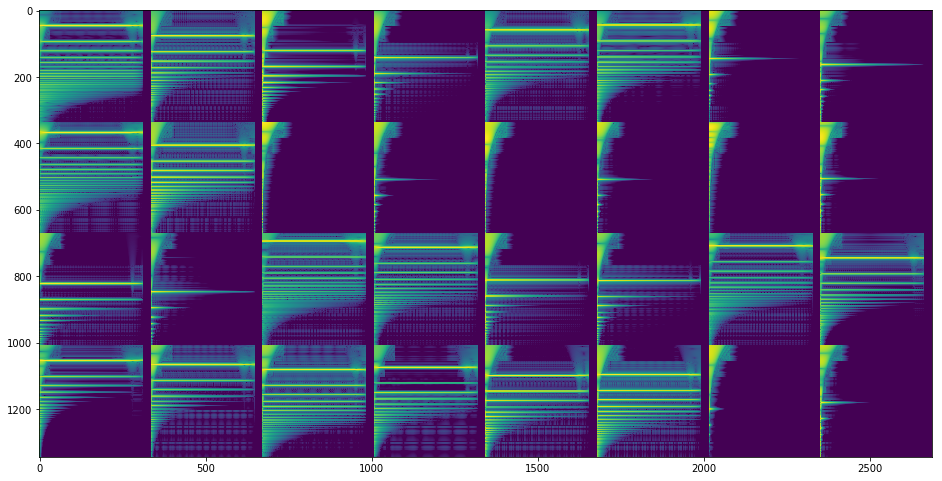

In [585]:
plt.figure(figsize=(16,12))
plt.imshow(merge_images(inputs.numpy()[:16], pred_cqts[:16]))

In [586]:
for i in range(len(gt_samples)):
    print("GT")
    display(Audio(gt_samples[i], rate=36000))
    print("Pred")
    display(Audio(pred_samples[i], rate=36000))

GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


In [590]:
def sample_params(size):
    stringNumber = np.array([math.floor(np.random.choice(np.arange(0, 6))) for _ in range(size)], dtype=np.int32)
    tab = np.array([math.floor(np.random.choice(np.arange(0, 12))) for _ in range(size)], dtype=np.int32)
#     print(stringNumber)
#     print(tab)
    #  ipdb.set_trace()
    guitars = []
    audio_buffers = []
    cqt_specs = []
    for i in range(size):
        guitars.append(Guitar(options=Options()))
        audio_buffers.append(play_note(guitars[i], stringNumber[i], tab[i]))
        cqt_spec = compute_cqt_spec(audio_buffers[i]).T
        padded_cqt = pad_zeros(cqt_spec, (cqt_spec.shape[1], cqt_spec.shape[1]))
        cqt_specs.append(padded_cqt)
    cqt_specs = np.array(cqt_specs, dtype=np.float32)
    print(cqt_specs.shape)
    return stringNumber, tab, cqt_specs
        

def generate_data(file, size):
    stringNumber, tab, cqt_specs = sample_params(size)
    with open(file, 'wb') as fh:
        data_dict = {'parameters' : np.array([stringNumber, tab]).T, 'cqt_spec' : cqt_specs}
        pkl.dump(data_dict, fh)
    fh.close()
    print(file)
    
    
def read_data(file):
    with open(file, 'rb') as fh:
        data = pkl.loads(fh.read())
    fh.close()
    return data


def create_datasets():
    generate_data('2fac_val.pkl', 100)
#     generate_data('test.pkl', 5000)
#     generate_data('eval.pkl', 5000)
#     generate_data('train.pkl', 50000)
    generate_data('2fac_test.pkl', 100)
    generate_data('2fac_eval.pkl', 100)
    generate_data('2fac_train.pkl', 500)

    
def read_dataset():
    return read_data('2fac_train.pkl'), read_data('2fac_test.pkl'), read_data('2fac_val.pkl'), read_data('2fac_eval.pkl')

In [591]:
create_datasets()

(100, 336, 336)
2fac_val.pkl
(100, 336, 336)
2fac_test.pkl
(100, 336, 336)
2fac_eval.pkl
(500, 336, 336)
2fac_train.pkl


In [596]:
train_data, test_data, val_data, eval_data = read_dataset()

In [648]:
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

trainset = MyDataset(parameters=train_data['parameters'], cqt_spectrograms=train_data['cqt_spec'])
trainloader = torch.utils.data.DataLoader(trainset, batch_size=4,
                                          shuffle=True, num_workers=2)

testset = MyDataset(parameters=test_data['parameters'], cqt_spectrograms=test_data['cqt_spec'])
testloader = torch.utils.data.DataLoader(testset, batch_size=4,
                                         shuffle=False, num_workers=2)

valset = MyDataset(parameters=val_data['parameters'], cqt_spectrograms=val_data['cqt_spec'])
valloader = torch.utils.data.DataLoader(valset, batch_size=4,
                                         shuffle=False, num_workers=2)

evalset = MyDataset(parameters=eval_data['parameters'], cqt_spectrograms=eval_data['cqt_spec'])
evalloader = torch.utils.data.DataLoader(evalset, batch_size=4,
                                         shuffle=False, num_workers=2)

In [657]:
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(1, 6, 5)
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(6, 16, 5)
        self.fc1 = nn.Linear(9 * 108 * 108, 360)
        self.fc2 = nn.Linear(360, 84)
        self.fc3 = nn.Linear(84, 2)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = x.view(-1, 9 * 108 * 108)  # -1 is the batch_size
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = F.dropout(x, training=self.training)    
        x = self.fc3(x)
        return x


net = Net()

In [658]:
criterion = nn.MSELoss()
#optimizer = optim.SGD(net.parameters(), lr=0.001, momentum=0.9)
optimizer = optim.Adam(net.parameters(), lr=0.001, weight_decay=1e-6)
net.train()

Net(
  (conv1): Conv2d(1, 6, kernel_size=(5, 5), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2): Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1))
  (fc1): Linear(in_features=104976, out_features=360, bias=True)
  (fc2): Linear(in_features=360, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=2, bias=True)
)

In [659]:
for epoch in range(200):  # loop over the dataset multiple times
    #net.train()
    running_loss = 0.0

    for i, data in enumerate(trainloader, 0):
        # get the inputs
        inputs, labels = data
        #print(inputs.shape)
        #print(labels.shape)
        inputs.unsqueeze_(1)
        #print(inputs.shape)
        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = net(inputs)
        loss = criterion(outputs, labels.float())
        loss.backward()
        optimizer.step()

        # print statistics
        running_loss += loss.item()
#        if i % 500 == 0:    # print every 20 mini-batches
#            print('[%d, %5d] loss: %.3f' %
#                  (epoch + 1, i + 1, running_loss/500))
#            running_loss = 0.0

    print('epoch %d train_loss: %.6f' % (epoch + 1, running_loss/float(len(trainloader.dataset))))
    with open("2fac_train_losses.txt", "a") as text_file:
        text_file.write(str(running_loss/float(len(trainloader.dataset))))
        text_file.write("\n")
    
    val_loss = evaluate(net, valloader)
    print('epoch %d val_loss: %.6f' % (epoch + 1, val_loss))
    with open("2fac_val_losses.txt", "a") as text_file:
        text_file.write(str(val_loss))
        text_file.write("\n")
    torch.save(net.state_dict(), '2fac_checkpoint.pt')

print('Finished Training')

epoch 1 train_loss: 2.285599
epoch 1 val_loss: 2.047900
epoch 2 train_loss: 2.044311
epoch 2 val_loss: 1.809084
epoch 3 train_loss: 1.942799
epoch 3 val_loss: 2.257735
epoch 4 train_loss: 1.813616
epoch 4 val_loss: 1.784414
epoch 5 train_loss: 1.838604
epoch 5 val_loss: 1.658143
epoch 6 train_loss: 1.609416
epoch 6 val_loss: 1.616440
epoch 7 train_loss: 1.509190
epoch 7 val_loss: 1.479791
epoch 8 train_loss: 1.575089
epoch 8 val_loss: 1.565227
epoch 9 train_loss: 1.573813
epoch 9 val_loss: 1.663898
epoch 10 train_loss: 1.538780
epoch 10 val_loss: 1.555171
epoch 11 train_loss: 1.648705
epoch 11 val_loss: 1.600638
epoch 12 train_loss: 1.562800
epoch 12 val_loss: 1.260833
epoch 13 train_loss: 1.433985
epoch 13 val_loss: 1.354392
epoch 14 train_loss: 1.386085
epoch 14 val_loss: 1.719675
epoch 15 train_loss: 1.428249
epoch 15 val_loss: 1.656046
epoch 16 train_loss: 1.396597
epoch 16 val_loss: 1.616948
epoch 17 train_loss: 1.376438
epoch 17 val_loss: 1.472807
epoch 18 train_loss: 1.271487
ep

Process Process-2979:
Process Process-2980:
Traceback (most recent call last):
Traceback (most recent call last):
  File "/anaconda3/envs/torch-env/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/anaconda3/envs/torch-env/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/anaconda3/envs/torch-env/lib/python3.6/multiprocessing/process.py", line 93, in run
    self._target(*self._args, **self._kwargs)
  File "/anaconda3/envs/torch-env/lib/python3.6/multiprocessing/process.py", line 93, in run
    self._target(*self._args, **self._kwargs)
  File "/anaconda3/envs/torch-env/lib/python3.6/site-packages/torch/utils/data/dataloader.py", line 52, in _worker_loop
    r = index_queue.get()
  File "/anaconda3/envs/torch-env/lib/python3.6/site-packages/torch/utils/data/dataloader.py", line 52, in _worker_loop
    r = index_queue.get()
  File "/anaconda3/envs/torch-env/lib/python3.6/multiprocessing/queues.py", line 335

KeyboardInterrupt: 

In [738]:
inputs, targets = iter(trainloader).next()

gt_samples = []
gt_stringNumbers = []
gt_tabs = []

for i in range(len(targets)):
    gt_stringNumber, gt_tab = targets.numpy()[i]
    guitar = Guitar(options=Options())
    gt_stringNumbers.append(gt_stringNumber)
    gt_tabs.append(gt_tab)
    #print("gt_stringNumber: %.3f, gt_tab: %.3f" % (gt_stringNumber, gt_tab))
    audio_buffer = play_note(guitar, int(round(gt_stringNumber)), int(round(gt_tab)))
    cqt_spec = compute_cqt_spec(audio_buffer).T
    padded_cqt = pad_zeros(cqt_spec, (cqt_spec.shape[1], cqt_spec.shape[1]))
    
    gt_samples.append(audio_buffer)

print(gt_stringNumbers)
print(gt_tabs)

ValueError: too many values to unpack (expected 2)

In [606]:
#net.load_state_dict(torch.load('checkpoint.pt'))
net.eval()
preds = net(inputs.unsqueeze_(1))
preds = preds.detach().numpy()

pred_samples = []
pred_cqts = []
pred_stringNumbers = []
pred_tabs = []

for i in range(preds.shape[0]):
    pred_stringNumber, pred_tab = preds[i]
    guitar = Guitar(options=Options())
    #print("pred_stringNumber: %d, pred_tab: %d" % (int(round(pred_stringNumber)), int(round(pred_tab))))
    pred_stringNumbers.append(pred_stringNumber)
    pred_tabs.append(pred_tab)
    audio_buffer = play_note(guitar, int(round(pred_stringNumber)), int(round(pred_tab)))
    cqt_spec = compute_cqt_spec(audio_buffer).T
    padded_cqt = pad_zeros(cqt_spec, (cqt_spec.shape[1], cqt_spec.shape[1]))
    
    pred_cqts.append(padded_cqt.T)
    pred_samples.append(audio_buffer)

print(pred_stringNumbers)
print(pred_tabs)

[4.0562897, 4.665932, 0.2689827, 4.518748, 3.552772, 0.32493493, 0.41169173, 1.9758742, 4.0752316, 3.9347358, 2.398376, 1.5589383, 1.4796412, 2.3781471, 0.3937681, 1.057765, 2.9611979, 3.9361672, 2.3939328, 0.2236204, 0.3197127, 3.0971336, 1.0604224, 4.2692437, 1.0645349, 1.1645935, 0.28859794, 0.24589513, 2.644154, 2.5922318, 1.2563176, 1.9157218]
[5.362482, 8.569251, 3.7194717, 8.027161, 4.1463833, 3.7988741, 3.540122, 3.7701628, 8.034307, 6.24115, 3.019437, 5.8907795, 6.213249, 4.7760835, 3.6231265, 4.9206686, 5.040023, 5.051585, 4.1260953, 1.8877037, 2.7570353, 4.3589897, 4.865711, 5.821583, 2.769517, 3.0191853, 2.6303098, 3.5440097, 5.1647825, 3.1369236, 5.335558, 3.668422]


In [607]:
print(np.sum((np.array(gt_stringNumbers) - np.array(pred_stringNumbers))**2))
print(np.sum((np.array(gt_tabs) - np.array(pred_tabs))**2))

13.818913802702104
358.0464149763662


16 336 336


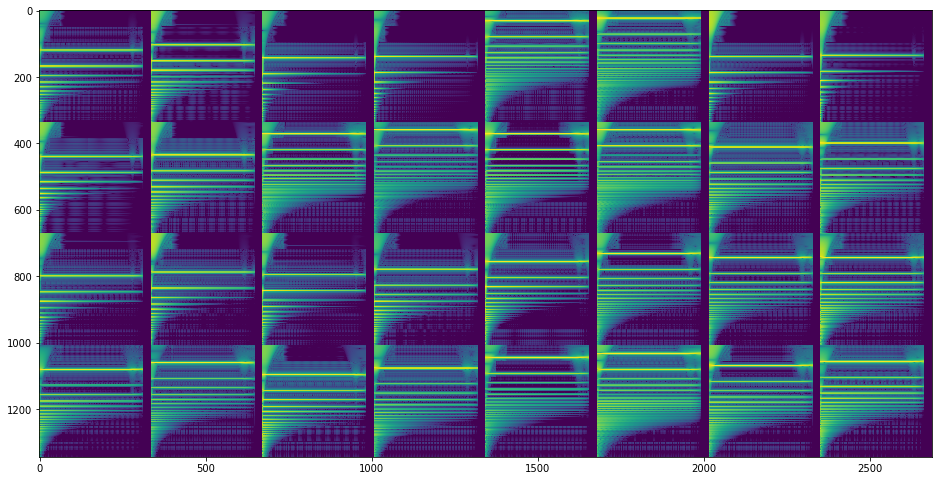

In [608]:
plt.figure(figsize=(16,12))
plt.imshow(merge_images(inputs.numpy()[:16], pred_cqts[:16]))

In [609]:
for i in range(len(gt_samples)):
    print("GT")
    display(Audio(gt_samples[i], rate=36000))
    print("Pred")
    display(Audio(pred_samples[i], rate=36000))

GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


GT


Pred


In [709]:
# target:pitch from freqs -> compute stringNumber, tab -> pluck -> cqt
# input:cqt -> learn freqs

a0_hz = 27.5
c0_hz = a0_hz * math.pow(2, -9 / 12)

def compute_freq(octave, semitone):
    basicHz = c0_hz * math.pow(2, octave + semitone / 12)
    return basicHz


def compute_basicHz():
    basicHz = []
    basicHz.append(c0_hz * math.pow(2, 2 + 4 / 12))  #E2
    basicHz.append(c0_hz * math.pow(2, 2 + 9 / 12))  #A2
    basicHz.append(c0_hz * math.pow(2, 3 + 2 / 12))  #D3
    basicHz.append(c0_hz * math.pow(2, 3 + 7 / 12))  #G3
    basicHz.append(c0_hz * math.pow(2, 3 + 11 / 12)) #B3
    basicHz.append(c0_hz * math.pow(2, 4 + 4 / 12))  #E4
    return basicHz
    
    
def compute_freqs(num_frets):
    freqs = []
    num_octaves = 2 + num_frets // 12
    num_semitones = num_octaves * 12 + num_frets % 12 + 1
    for i in range(4, num_semitones + 4):
        freqs.append(compute_freq(2, i))
    return freqs

                   
def compute_pitch(stringNumber, fret):
    strings = compute_basicHz()
    return strings[stringNumber] * math.pow(2, fret/12)

                   
def get_string_tab(freq, num_frets):
    l = []
    for i in range(6):
        for j in range(num_frets + 1):
            if math.isclose(compute_pitch(i, j), freq, rel_tol=1e-5):
                   l.append([int(round(i)), int(round(j))])
    return l

In [689]:
num_frets = 20
freqs = compute_freqs(20)
#print(freqs)

#print(get_string_tab(1046.5023, 20))
def sample_params(size):
    character_variation = np.array([np.random.uniform(0, 1) for _ in range(size)], dtype=np.float32)
    string_damping = np.array([np.random.uniform(0, 0.7) for _ in range(size)], dtype=np.float32)
    string_damping_variation = np.array([np.random.uniform(0, 0.5) for _ in range(size)], dtype=np.float32)
    pluck_damping = np.array([np.random.uniform(0, 0.9) for _ in range(size)], dtype=np.float32)
    pluck_damping_variation = np.array([np.random.uniform(0, 0.5) for _ in range(size)], dtype=np.float32)
    string_tension = np.array([np.random.uniform(0, 1) for _ in range(size)], dtype=np.float32)
    stereo_spread = np.array([np.random.uniform(0, 1) for _ in range(size)], dtype=np.float32)
    pitch = np.array([np.random.choice(np.array(freqs)) for _ in range(size)], dtype=np.float32)
#     print(stringNumber)
#     print(tab)
    #  ipdb.set_trace()
    options = []
    guitars = []
    audio_buffers = []
    cqt_specs = []
    for i in range(size):
        options.append(Options(character_variation[i], string_damping[i], string_damping_variation[i], pluck_damping[i], pluck_damping_variation[i], 
                         string_tension[i], stereo_spread[i]))
        guitars.append(Guitar(options=options[i]))
#         print(pitch[i])
#         print(get_string_tab(pitch[i], num_frets))
        stringNumber, tab = get_string_tab(pitch[i], num_frets)[0]
        audio_buffers.append(play_note(guitars[i], stringNumber, tab))
        cqt_spec = compute_cqt_spec(audio_buffers[i]).T
        padded_cqt = pad_zeros(cqt_spec, (cqt_spec.shape[1], cqt_spec.shape[1]))
        cqt_specs.append(padded_cqt)
    cqt_specs = np.array(cqt_specs, dtype=np.float32)
    print(cqt_specs.shape)
    return character_variation, string_damping, string_damping_variation, pluck_damping, pluck_damping_variation, string_tension, stereo_spread, pitch, cqt_specs
        

def generate_data(file, size):
    character_variation, string_damping, string_damping_variation, pluck_damping, pluck_damping_variation, string_tension, stereo_spread, pitch, cqt_specs = sample_params(size)
    with open(file, 'wb') as fh:
        data_dict = {'parameters' : np.array([character_variation, string_damping, string_damping_variation, pluck_damping, pluck_damping_variation, string_tension, 
                stereo_spread, pitch]).T, 'cqt_spec' : cqt_specs}
        pkl.dump(data_dict, fh)
    fh.close()
    print(file)
    
    
def read_data(file):
    with open(file, 'rb') as fh:
        data = pkl.loads(fh.read())
    fh.close()
    return data


def create_datasets():
    generate_data('p_val_.pkl', 100)
#     generate_data('test.pkl', 5000)
#     generate_data('eval.pkl', 5000)
#     generate_data('train.pkl', 50000)
    generate_data('p_test_.pkl', 100)
    generate_data('p_eval_.pkl', 100)
    generate_data('p_train_.pkl', 500)

    
def read_dataset():
    return read_data('p_train_.pkl'), read_data('p_test_.pkl'), read_data('p_val_.pkl'), read_data('p_eval_.pkl')

In [687]:
create_datasets()

(100, 336, 336)
p_val_.pkl
(100, 336, 336)
p_test_.pkl
(100, 336, 336)
p_eval_.pkl
(500, 336, 336)
p_train_.pkl


In [690]:
train_data, test_data, val_data, eval_data = read_dataset()

In [703]:
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

trainset = MyDataset(parameters=train_data['parameters'], cqt_spectrograms=train_data['cqt_spec'])
trainloader = torch.utils.data.DataLoader(trainset, batch_size=4,
                                          shuffle=True, num_workers=2)

testset = MyDataset(parameters=test_data['parameters'], cqt_spectrograms=test_data['cqt_spec'])
testloader = torch.utils.data.DataLoader(testset, batch_size=4,
                                         shuffle=False, num_workers=2)

valset = MyDataset(parameters=val_data['parameters'], cqt_spectrograms=val_data['cqt_spec'])
valloader = torch.utils.data.DataLoader(valset, batch_size=4,
                                         shuffle=False, num_workers=2)

evalset = MyDataset(parameters=eval_data['parameters'], cqt_spectrograms=eval_data['cqt_spec'])
evalloader = torch.utils.data.DataLoader(evalset, batch_size=4,
                                         shuffle=False, num_workers=2)

In [704]:
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(1, 6, 5)
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(6, 16, 5)
        self.fc1 = nn.Linear(9 * 108 * 108, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 8)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = x.view(-1, 9 * 108 * 108)  # -1 is the batch_size
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x


net = Net()

In [705]:
criterion = nn.MSELoss()
#optimizer = optim.SGD(net.parameters(), lr=0.001, momentum=0.9)
optimizer = optim.Adam(net.parameters(), lr=0.001)

In [706]:
for epoch in range(200):  # loop over the dataset multiple times

    running_loss = 0.0

    for i, data in enumerate(trainloader, 0):
        # get the inputs
        inputs, labels = data
        #print(inputs.shape)
        #print(labels.shape)
        inputs.unsqueeze_(1)
        #print(inputs.shape)
        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = net(inputs)
        loss = criterion(outputs, labels.float())
        loss.backward()
        optimizer.step()

        # print statistics
        running_loss += loss.item()
#        if i % 500 == 0:    # print every 20 mini-batches
#            print('[%d, %5d] loss: %.3f' %
#                  (epoch + 1, i + 1, running_loss/500))
#            running_loss = 0.0

    print('epoch %d train_loss: %.6f' % (epoch + 1, running_loss/float(len(trainloader.dataset))))
    with open("p_train_losses.txt", "a") as text_file:
        text_file.write(str(running_loss/float(len(trainloader.dataset))))
        text_file.write("\n")
    
    val_loss = evaluate(net, valloader)
    print('epoch %d val_loss: %.6f' % (epoch + 1, val_loss))
    with open("p_val_losses.txt", "a") as text_file:
        text_file.write(str(val_loss))
        text_file.write("\n")
    torch.save(net.state_dict(), 'p_checkpoint.pt')

print('Finished Training')

epoch 1 train_loss: 2449.962782
epoch 1 val_loss: 1995.043246
epoch 2 train_loss: 1510.167074
epoch 2 val_loss: 1487.707106
epoch 3 train_loss: 1489.493933
epoch 3 val_loss: 1504.019781
epoch 4 train_loss: 1387.777484
epoch 4 val_loss: 1508.452426
epoch 5 train_loss: 1349.779989
epoch 5 val_loss: 1385.334972
epoch 6 train_loss: 1424.181202
epoch 6 val_loss: 1470.126469
epoch 7 train_loss: 1274.373416
epoch 7 val_loss: 1337.988396
epoch 8 train_loss: 1304.243864
epoch 8 val_loss: 1428.757130
epoch 9 train_loss: 1294.970095
epoch 9 val_loss: 2278.377782
epoch 10 train_loss: 1246.194109
epoch 10 val_loss: 1425.349885
epoch 11 train_loss: 1276.203556
epoch 11 val_loss: 1308.020466
epoch 12 train_loss: 1248.549579
epoch 12 val_loss: 1263.950368
epoch 13 train_loss: 1239.060924
epoch 13 val_loss: 1277.825881
epoch 14 train_loss: 1235.219875
epoch 14 val_loss: 1401.050094
epoch 15 train_loss: 1229.638500
epoch 15 val_loss: 1382.536088
epoch 16 train_loss: 1180.324351
epoch 16 val_loss: 1203.8

epoch 132 train_loss: 63.856438
epoch 132 val_loss: 533.978545
epoch 133 train_loss: 76.265501
epoch 133 val_loss: 438.639449
epoch 134 train_loss: 59.532310
epoch 134 val_loss: 420.318332
epoch 135 train_loss: 66.031430
epoch 135 val_loss: 403.818434
epoch 136 train_loss: 57.592903
epoch 136 val_loss: 437.525835
epoch 137 train_loss: 63.210029
epoch 137 val_loss: 413.871265
epoch 138 train_loss: 66.261007
epoch 138 val_loss: 399.545422
epoch 139 train_loss: 73.902043
epoch 139 val_loss: 435.053082
epoch 140 train_loss: 64.399949
epoch 140 val_loss: 429.064205
epoch 141 train_loss: 55.891508
epoch 141 val_loss: 435.026577
epoch 142 train_loss: 57.663697
epoch 142 val_loss: 452.413149
epoch 143 train_loss: 75.683943
epoch 143 val_loss: 414.114364
epoch 144 train_loss: 48.109408
epoch 144 val_loss: 431.248800
epoch 145 train_loss: 47.167514
epoch 145 val_loss: 421.458404
epoch 146 train_loss: 51.604638
epoch 146 val_loss: 408.346210
epoch 147 train_loss: 59.554657
epoch 147 val_loss: 443

Process Process-3740:
Process Process-3739:
Traceback (most recent call last):
Traceback (most recent call last):
  File "/anaconda3/envs/torch-env/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/anaconda3/envs/torch-env/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/anaconda3/envs/torch-env/lib/python3.6/multiprocessing/process.py", line 93, in run
    self._target(*self._args, **self._kwargs)
  File "/anaconda3/envs/torch-env/lib/python3.6/multiprocessing/process.py", line 93, in run
    self._target(*self._args, **self._kwargs)
  File "/anaconda3/envs/torch-env/lib/python3.6/site-packages/torch/utils/data/dataloader.py", line 52, in _worker_loop
    r = index_queue.get()
  File "/anaconda3/envs/torch-env/lib/python3.6/site-packages/torch/utils/data/dataloader.py", line 52, in _worker_loop
    r = index_queue.get()
  File "/anaconda3/envs/torch-env/lib/python3.6/multiprocessing/queues.py", line 335

KeyboardInterrupt: 

In [ ]:
testset = MyDataset(parameters=train_data['parameters'], cqt_spectrograms=train_data['cqt_spec'])
testloader = torch.utils.data.DataLoader(testset, batch_size=32,
                                         shuffle=False, num_workers=2)

inputs, targets = iter(testloader).next()

gt_samples = []
gt_pitches = []
gt_stringNumbers = []
gt_tabs = []
gt_string_tensions = []

for i in range(len(targets)):
    gt_character_variation, gt_string_damping, gt_string_damping_variation, gt_pluck_damping, gt_pluck_damping_variation, gt_string_tension, gt_stereo_spread, gt_pitch = targets.numpy()[i]
    options = Options(gt_character_variation, gt_string_damping, gt_string_damping_variation, gt_pluck_damping, gt_pluck_damping_variation, gt_string_tension, gt_stereo_spread)
    guitar = Guitar(options=options)
    gt_pitches.append(gt_pitch)
    gt_string_tensions.append(gt_string_tension)
    #print(gt_pitch)
    #print("gt_stringNumber: %.3f, gt_tab: %.3f" % (gt_stringNumber, gt_tab))
    stringNumber, tab = get_string_tab(gt_pitch, num_frets)[0]
    gt_stringNumbers.append(stringNumber)
    gt_tabs.append(tab)
    audio_buffer = play_note(guitar, stringNumber, tab)
    cqt_spec = compute_cqt_spec(audio_buffer).T
    padded_cqt = pad_zeros(cqt_spec, (cqt_spec.shape[1], cqt_spec.shape[1]))
    
    gt_samples.append(audio_buffer)

print(gt_stringNumbers)
print(gt_tabs)

In [724]:
def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return array[idx]

In [799]:
net.load_state_dict(torch.load('p_checkpoint.pt'))
#print(compute_freqs(20))
freqs = compute_freqs(20)
preds = net(inputs.unsqueeze_(1))
preds = preds.detach().numpy()

pred_samples = []
pred_cqts = []
pred_pitches = []
pred_stringNumbers = []
pred_tabs = []

for i in range(preds.shape[0]):
    pred_character_variation, pred_string_damping, pred_string_damping_variation, pred_pluck_damping, pred_pluck_damping_variation, pred_string_tension, pred_stereo_spread, pred_pitch = preds[i]
    options = Options(pred_character_variation, pred_string_damping, pred_string_damping_variation, pred_pluck_damping, pred_pluck_damping_variation, gt_string_tensions[i], pred_stereo_spread)
    guitar = Guitar(options=options)
    #print("pred_stringNumber: %d, pred_tab: %d" % (int(round(pred_stringNumber)), int(round(pred_tab))))
    pred_pitches.append(pred_pitch)
    #print(pred_pitch)
    print(find_nearest(np.array(freqs), pred_pitch))
    print(get_string_tab(find_nearest(np.array(freqs), pred_pitch), num_frets))
    stringNumber, tab = get_string_tab(find_nearest(np.array(freqs), pred_pitch), num_frets)[0]
    pred_stringNumbers.append(stringNumber)
    pred_tabs.append(tab)
    audio_buffer = play_note(guitar, stringNumber, tab)
    cqt_spec = compute_cqt_spec(audio_buffer).T
    padded_cqt = pad_zeros(cqt_spec, (cqt_spec.shape[1], cqt_spec.shape[1]))
    
    pred_cqts.append(padded_cqt.T)
    pred_samples.append(audio_buffer)

print(pred_stringNumbers)
print(pred_tabs)

123.47082531403102
[[0, 7], [1, 2]]
184.9972113558172
[[0, 14], [1, 9], [2, 4]]
783.9908719634989
[[4, 20], [5, 15]]
391.99543598174944
[[2, 17], [3, 12], [4, 8], [5, 3]]
493.8833012561239
[[3, 16], [4, 12], [5, 7]]
932.3275230361802
[[5, 18]]
130.8127826502993
[[0, 8], [1, 3]]


/anaconda3/envs/torch-env/lib/python3.6/site-packages/ipykernel/__main__.py:168: RuntimeWarning: overflow encountered in double_scalars
/anaconda3/envs/torch-env/lib/python3.6/site-packages/ipykernel/__main__.py:167: RuntimeWarning: invalid value encountered in double_scalars
/anaconda3/envs/torch-env/lib/python3.6/site-packages/ipykernel/__main__.py:164: RuntimeWarning: overflow encountered in double_scalars
/anaconda3/envs/torch-env/lib/python3.6/site-packages/ipykernel/__main__.py:163: RuntimeWarning: invalid value encountered in double_scalars


ParameterError: Audio buffer is not finite everywhere

4 336 336


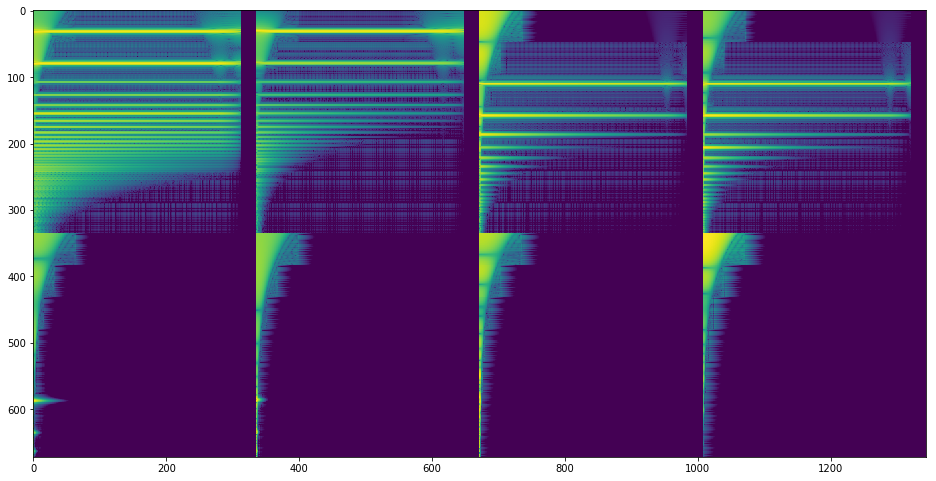

In [792]:
plt.figure(figsize=(16,12))
plt.imshow(merge_images(inputs.numpy()[:16], pred_cqts[:16]))

In [794]:
for i in range(len(gt_samples)):
    print("GT")
    display(Audio(gt_samples[i], rate=40000))
    print("Pred")
    display(Audio(pred_samples[i], rate=40000))

GT


Pred


GT


Pred


GT


Pred


GT


Pred
